In [997]:
import pandas as pd
import numpy as np
import seaborn as sns
sns.set()
import patsy
import string
from scipy.sparse import hstack
from sklearn.decomposition import PCA
from pandas import DataFrame
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.preprocessing import LabelEncoder
from sklearn.multiclass import OneVsRestClassifier
from sklearn.neighbors import KNeighborsClassifier
import sklearn.metrics as metrics
from sklearn.decomposition import NMF
import scipy.stats as stats
pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 1000)
import statsmodels.api as sm
import statsmodels.formula.api as smf
from sklearn import preprocessing
%matplotlib inline
from sklearn.metrics import mean_squared_error,r2_score
from math import sqrt
from sklearn.preprocessing import StandardScaler, PolynomialFeatures
from sklearn.datasets import make_regression
from sklearn.pipeline import make_pipeline
from sklearn.datasets import load_diabetes
from sklearn.linear_model import Lasso, Ridge, ElasticNet, LinearRegression
from sklearn.linear_model import LassoCV, RidgeCV,ElasticNetCV
from sklearn.model_selection import (cross_val_score, train_test_split, KFold, GridSearchCV)
from spacy import displacy
import re, nltk, spacy, gensim
from sklearn.decomposition import LatentDirichletAllocation, TruncatedSVD
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from sklearn.model_selection import GridSearchCV
from pprint import pprint
from nltk.corpus import stopwords
from wordcloud import WordCloud
from sklearn import svm
from sklearn.model_selection import StratifiedKFold, cross_val_score
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix, roc_auc_score, recall_score, precision_score, accuracy_score, classification_report, f1_score

/Users/a.groon/opt/anaconda3/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


# Read Data from CSV

In [998]:
data = pd.read_csv('resume_dataset.csv')
df2 = pd.read_csv('resume_dataset2.csv')
data = pd.concat([data, df2])



/Users/a.groon/opt/anaconda3/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


# EDA

In [999]:
data

/Users/a.groon/opt/anaconda3/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


Category  \
0     Data Science   
1     Data Science   
2     Data Science   
3     Data Science   
4     Data Science   
...            ...   
1214      Aviation   
1215      Aviation   
1216      Aviation   
1217      Aviation   
1218      Aviation   

                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                 

/Users/a.groon/opt/anaconda3/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


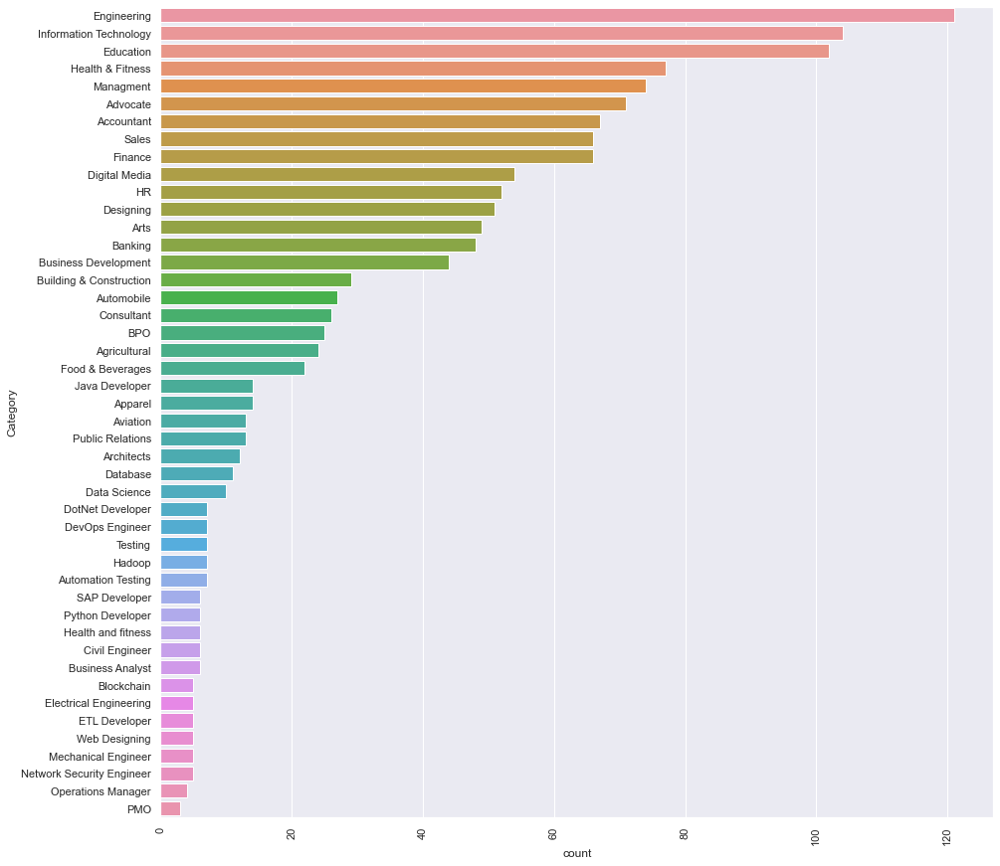

In [1000]:
plt.figure(figsize=(15,15))
plt.xticks(rotation=90)
sns.countplot(y='Category',data=data,order=data['Category'].value_counts().index)
plt.show()

In [1001]:
data.isnull().sum().sum()

/Users/a.groon/opt/anaconda3/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


169

In [1002]:
data.isnull().sum()

/Users/a.groon/opt/anaconda3/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


Category      0
Resume        0
ID          169
dtype: int64

In [1003]:
data= data.drop(['ID'],axis=1) 

/Users/a.groon/opt/anaconda3/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [1004]:
data.duplicated(subset=['Resume']).sum()

/Users/a.groon/opt/anaconda3/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


131

In [1005]:
data.drop_duplicates(inplace=True)
data

/Users/a.groon/opt/anaconda3/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


Category  \
0     Data Science   
1     Data Science   
2     Data Science   
3     Data Science   
4     Data Science   
...            ...   
1214      Aviation   
1215      Aviation   
1216      Aviation   
1217      Aviation   
1218      Aviation   

                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                 

In [1006]:
var_mod = ['Category']
le = LabelEncoder()
for i in var_mod:
    data[i] = le.fit_transform(data[i])

/Users/a.groon/opt/anaconda3/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [1007]:
data

/Users/a.groon/opt/anaconda3/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


Category  \
0           17   
1           17   
2           17   
3           17   
4           17   
...        ...   
1214         8   
1215         8   
1216         8   
1217         8   
1218         8   

                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                             

# NLP

In [1008]:
nltk.download('stopwords')
stopwords = nltk.corpus.stopwords.words('english')

def clean_text(text):
    #convert text to lowercase
    text = text.lower() 
    #remove any numeric characters
    text = ''.join([word for word in text if not word.isdigit()]) 

#     text = [word for word in text if re.search("\d", word)== None]
    # remove URLs
    text = re.sub('http\S+\s*', ' ', text)  
    # remove RT and cc
    text = re.sub('RT|cc', ' ', text)
    # remove hashtags
    text = re.sub('#\S+', '', text)  
    # remove mentions
    text = re.sub('@\S+', '  ', text)  
    #punctuations removal
    text = "".join([word for word in text if word not in string.punctuation])
    text = re.sub("\W", " ", str(text))
    #stopwords removal
    ext = [word for word in text.split() if word not in stopwords]
    #replace consecutive non-ASCII characters with a space
    text = re.sub(r'[^\x00-\x7f]',r' ', text) 
    #extra whitespace removal
    text = re.sub('\s+', ' ', text)
    return text

data['Resume'] = data['Resume'].apply(lambda x: clean_text(x))


/Users/a.groon/opt/anaconda3/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
<>:12: DeprecationWarning: invalid escape sequence \S
<>:16: DeprecationWarning: invalid escape sequence \S
<>:18: DeprecationWarning: invalid escape sequence \S
<>:21: DeprecationWarning: invalid escape sequence \W
<>:27: DeprecationWarning: invalid escape sequence \s
<>:12: DeprecationWarning: invalid escape sequence \S
<>:16: DeprecationWarning: invalid escape sequence \S
<>:18: DeprecationWarning: invalid escape sequence \S
<>:21: DeprecationWarning: invalid escape sequence \W
<>:27: DeprecationWarning: invalid escape sequence \s
<ipython-input-1008-e628a91a5a0f>:12: DeprecationWarning: invalid escape sequence \S
  t

In [1009]:
data

/Users/a.groon/opt/anaconda3/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


Category  \
0           17   
1           17   
2           17   
3           17   
4           17   
...        ...   
1214         8   
1215         8   
1216         8   
1217         8   
1218         8   

                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                             

In [1010]:
#pd.set_option('max_colwidth', None)
#data['Resume'].head(1)

/Users/a.groon/opt/anaconda3/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [1011]:

alphanumeric = lambda x: re.sub('\w*\d\w*', ' ', x)
punc_lower = lambda x: re.sub('[%s]' % re.escape(string.punctuation), ' ', x.lower())
data['Resume'] = data.Resume.map(alphanumeric).map(punc_lower)
data

/Users/a.groon/opt/anaconda3/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
<>:1: DeprecationWarning: invalid escape sequence \w
<>:1: DeprecationWarning: invalid escape sequence \w
<ipython-input-1011-2f59724d18a1>:1: DeprecationWarning: invalid escape sequence \w
  alphanumeric = lambda x: re.sub('\w*\d\w*', ' ', x)


Category  \
0           17   
1           17   
2           17   
3           17   
4           17   
...        ...   
1214         8   
1215         8   
1216         8   
1217         8   
1218         8   

                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                             

In [1012]:
import neattext.functions as nf

/Users/a.groon/opt/anaconda3/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [1013]:
data['Resume'] = data['Resume'].apply(nf.remove_puncts)
data['Resume'] = data['Resume'].apply(nf.remove_numbers)
data['Resume'] = data['Resume'].apply(nf.remove_multiple_spaces)
data['Resume'] = data['Resume'].apply(nf.remove_special_characters)
data['Resume'] = data['Resume'].apply(nf.remove_stopwords)
data['Resume'] = data['Resume'].apply(nf.remove_postoffice_box)
#data['Resume'] = data['Resume'].apply(nf.digit2words)
data['Resume'] = data['Resume'].apply(nf.remove_dates)
data['Resume'] = data['Resume'].apply(nf.remove_shortwords)
data['Resume'] = data['Resume'].apply(nf.remove_street_address)
data['Resume'] = data['Resume'].str.replace('xef', '')
data['Resume'] = data['Resume'].str.replace('resume', '')
data['Resume'] = data['Resume'].str.replace('data', '')
data['Resume'] = data['Resume'].str.replace('present', '')
data['Resume'] = data['Resume'].str.replace('skill', '')
data['Resume'] = data['Resume'].str.replace('year', '')
data['Resume'] = data['Resume'].str.replace('experience', '')
data['Resume'] = data['Resume'].str.replace('university', '')
data['Resume'] = data['Resume'].str.replace('neducation', '')
data['Resume'] = data['Resume'].str.replace('team', '')
data['Resume'] = data['Resume'].str.replace('resumes', '')
data['Resume'] = data['Resume'].str.replace('school', '')
data['Resume'] = data['Resume'].str.replace('ngpa', '')
data['Resume'] = data['Resume'].str.replace('sure', '')
data['Resume'] = data['Resume'].str.replace('verbs', '')
data['Resume'] = data['Resume'].str.replace('cover', '')
data['Resume'] = data['Resume'].str.replace('nyour', '')
data['Resume'] = data['Resume'].str.replace('nyou', '')
data['Resume'] = data['Resume'].str.replace('font', '')
data['Resume'] = data['Resume'].str.replace('letter', '')
data['Resume'] = data['Resume'].str.replace('help', '')
data['Resume'] = data['Resume'].str.replace('dayjob', '')
data['Resume'] = data['Resume'].str.replace('looking', '')
data['Resume'] = data['Resume'].str.replace('info', '')
data['Resume'] = data['Resume'].str.replace('work', '')
data['Resume'] = data['Resume'].str.replace('nand', '')
data['Resume'] = data['Resume'].str.replace('rmation', '')
data['Resume'] = data['Resume'].str.replace('nprofessional', '')
data['Resume'] = data['Resume'].str.replace('college', '')
data['Resume'] = data['Resume'].str.replace('service', '')
data['Resume'] = data['Resume'].str.replace('examples', '')
data['Resume'] = data['Resume'].str.replace('narranged', '')
data['Resume'] = data['Resume'].str.replace('ncalculated', '')
data['Resume'] = data['Resume'].str.replace('nadapted', '')
data['Resume'] = data['Resume'].str.replace('nsolved', '')
data['Resume'] = data['Resume'].str.replace('ndiagnosed', '')
data['Resume'] = data['Resume'].str.replace('students ', '')
data['Resume'] = data['Resume'].str.replace('reverse', '')
data['Resume'] = data['Resume'].str.replace('title', '')
data['Resume'] = data['Resume'].str.replace('able', '')
data['Resume'] = data['Resume'].str.replace('street', '')
data['Resume'] = data['Resume'].str.replace('nkey', '')
data['Resume'] = data['Resume'].str.replace('good', '')
data['Resume'] = data['Resume'].str.replace('address', '')
data['Resume'] = data['Resume'].str.replace('pune', '')
data['Resume'] = data['Resume'].str.replace('till', '')
data['Resume'] = data['Resume'].str.replace('ing', '')
data['Resume'] = data['Resume'].str.replace('time', '')
data['Resume'] = data['Resume'].str.replace('including ', '')
data['Resume'] = data['Resume'].str.replace('ed ', '')
data['Resume'] = data['Resume'].str.replace('en ', '')
data['Resume'] = data['Resume'].str.replace('nobjective ', '')
data['Resume'] = data['Resume'].str.replace('chicago ', '')
data['Resume'] = data['Resume'].str.replace('xexx ', '')
data['Resume'] = data['Resume'].str.replace('hana ', '')


lower = lambda x : x.lower()
data['Resume'].map(lower)

/Users/a.groon/opt/anaconda3/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


0                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                       

In [1014]:
# delete verbs
#import nltk
##nltk.download('averaged_perceptron_tagger')
#clean_text = [sentence for sentence in data['Resume']]

#for x in clean_text : 
    #tokens = nltk.word_tokenize(x)
   # tagged = nltk.pos_tag(tokens)
    #tagged

/Users/a.groon/opt/anaconda3/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [1015]:
clean_text= [sentence for sentence in data['Resume']]
clean_text

/Users/a.groon/opt/anaconda3/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


['s programm languages python pandas numpy scipy scikitlearn matplotlib java javascriptjquery machine learn regression bayes random forest decision trees boost techniques cluster analysis word embedd sennt analysis natural language process dimensionality reduction topic modell neural nets base visualizations mysql sqlserver cassandra hbase elasticsearch dcjs plotly kibana matplotlib ggplot tau regular expression html angular logstash kafka python flask docker computer vision opunderstand deep learneducation details  science assurance associate science assurance associate ernst young llp details javascript exprience months jquery exprience months python exprience monthscompany details company ernst young description fraud investigations dispute s assurance technology assistreview technology assistreview assists elerat review process analytics generate reports core member  develop automatreview platform tool scratch assist disy domain tool implements predictive cod topic modell automat r

/Users/a.groon/opt/anaconda3/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


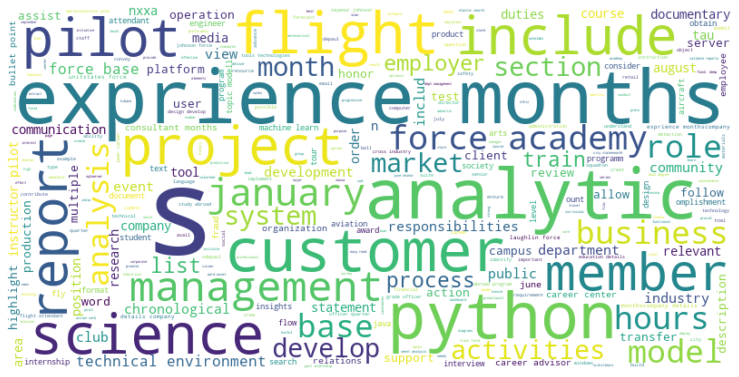

In [1016]:
cloud=WordCloud(background_color="white", max_words=5000, contour_width=3, contour_color='steelblue', width=800, height=400).generate(str(data["Resume"]))
fig=plt.figure(figsize=(13,18))
plt.axis("off")
plt.imshow(cloud,interpolation='bilinear');

# Count Vectoriztion & TfidfVectorizer

In [1017]:
cx=data.copy()
cx 

/Users/a.groon/opt/anaconda3/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


Category  \
0           17   
1           17   
2           17   
3           17   
4           17   
...        ...   
1214         8   
1215         8   
1216         8   
1217         8   
1218         8   

                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                             

In [1018]:

vectorizer = CountVectorizer(max_features=20000,
                             stop_words='english', token_pattern="\\b[a-z][a-z]+\\b",
                             binary=True)

doc_word = vectorizer.fit_transform(cx.Resume)
words = list(np.asarray(vectorizer.get_feature_names()))

/Users/a.groon/opt/anaconda3/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [1019]:
requiredText = data['Resume'].values
requiredTarget = data['Category'].values
word_vectorizer = TfidfVectorizer(
    sublinear_tf=True,
    stop_words='english',
    max_features=1500)
word_vectorizer.fit(requiredText)
WordFeatures = word_vectorizer.transform(requiredText)


/Users/a.groon/opt/anaconda3/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


/Users/a.groon/opt/anaconda3/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


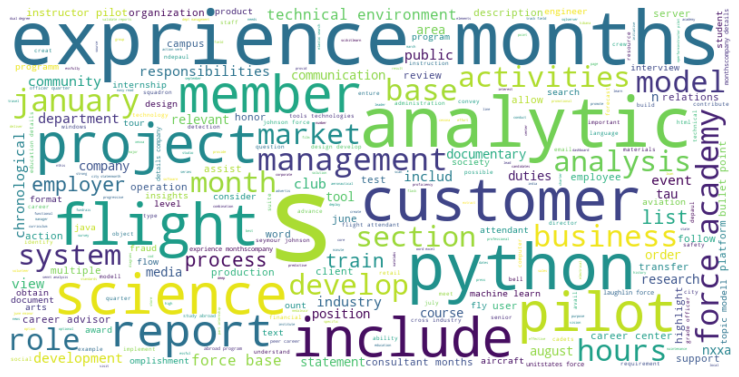

In [1020]:
cloud=WordCloud(background_color="white", max_words=5000, contour_width=3, contour_color='steelblue', width=800, height=400).generate(str(data["Resume"]))
fig=plt.figure(figsize=(13,18))
plt.axis("off")
plt.imshow(cloud,interpolation='bilinear');

# Topics Modelling

- LSA

In [1021]:
lsa = TruncatedSVD(n_components=10)
doc_topic = lsa.fit_transform(doc_word)
lsa.explained_variance_ratio_

/Users/a.groon/opt/anaconda3/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


array([0.05432217, 0.02089233, 0.01754474, 0.0142897 , 0.01246645,
       0.01091968, 0.00976337, 0.00930236, 0.00861373, 0.00851635])

In [1022]:
# Show top n keywords for each topic
def show_topics(vectorizer, model, n_words):
    keywords = np.array(vectorizer.get_feature_names())
    topic_keywords = []
    for topic_weights in model.components_:
        top_keyword_locs = (-topic_weights).argsort()[:n_words]
        topic_keywords.append(keywords.take(top_keyword_locs))
    return topic_keywords

/Users/a.groon/opt/anaconda3/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [1023]:
topic_keywords = show_topics(vectorizer=vectorizer, model=lsa, n_words=11)        
df_topic_keywords = pd.DataFrame(topic_keywords)
df_topic_keywords.columns = ['Word '+str(i) for i in range(df_topic_keywords.shape[1])]
df_topic_keywords.index = ['Topic '+str(i) for i in range(df_topic_keywords.shape[0])]
df_topic_keywords

#nthe email july april annual student nresearch includ customers board like base website risk xaand

/Users/a.groon/opt/anaconda3/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,Word 0,Word 1,Word 2,Word 3,Word 4,Word 5,Word 6,Word 7,Word 8,Word 9,Word 10
Topic 0,management,development,business,project,company,includ,design,develop,train,professional,analysis
Topic 1,chronological,want,spell,volunteer,important,employers,choose,possible,section,internship,bold
Topic 2,teach,national,conference,american,faculty,association,professor,student,fall,society,research
Topic 3,customer,ability,customers,relat,sales,like,details,description,permission,excellent,client
Topic 4,engineer,description,windows,test,software,programm,details,like,computer,java,html
Topic 5,sales,position,staff,financial,relat,compliance,procedures,satisfaction,employees,effectively,abilities
Topic 6,sales,cost,ounts,operations,safety,personnel,excel,budget,facility,ount,staff
Topic 7,design,development,analyst,unit,python,html,model,product,coordinator,mysql,specification
Topic 8,media,script,java,clients,windows,spanish,beta,intermediate,sports,grade,games
Topic 9,description,computer,education,monthscompany,exprience,windows,details,visual,technologies,systems,maharashtra


- NMF

In [1024]:
# Create an NMF instance: model
# the 12 components will be the topics
model = NMF(n_components=10, random_state=5)
# Fit the model to TF-IDF
model.fit(WordFeatures)
# Transform the TF-IDF: nmf_features
nmf_features = model.transform(WordFeatures)

/Users/a.groon/opt/anaconda3/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
/Users/a.groon/opt/anaconda3/lib/python3.8/site-packages/sklearn/decomposition/_nmf.py:312: FutureWarning: The 'init' value, when 'init=None' and n_components is less than n_samples and n_features, will be changed from 'nndsvd' to 'nndsvda' in 1.1 (renaming of 0.26).
  warnings.warn(("The 'init' value, when 'init=None' and "


In [1025]:
topic_keywords = show_topics(vectorizer=word_vectorizer, model=model, n_words=11)        
df_topic_keywords = pd.DataFrame(topic_keywords)
df_topic_keywords.columns = ['Word '+str(i) for i in range(df_topic_keywords.shape[1])]
df_topic_keywords.index = ['Topic '+str(i) for i in range(df_topic_keywords.shape[0])]
df_topic_keywords


/Users/a.groon/opt/anaconda3/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,Word 0,Word 1,Word 2,Word 3,Word 4,Word 5,Word 6,Word 7,Word 8,Word 9,Word 10
Topic 0,management,train,business,employee,operations,manager,performance,employees,resources,includ,development
Topic 1,details,exprience,description,months,maharashtra,company,monthscompany,january,education,mumbai,developer
Topic 2,include,list,student,education,career,position,teacher,read,want,relevant,section
Topic 3,java,software,developer,design,application,server,development,test,base,html,user
Topic 4,template,copyright,opyright,readnxcxa,download,link,relat,questions,permission,welcome,page
Topic 5,sales,market,customer,products,excellent,product,business,clients,responsible,generat,customers
Topic 6,financial,ount,bank,finance,ounts,ountant,cash,business,knowledge,reports,statements
Topic 7,engineer,mechanical,design,construction,electrical,civil,engineers,project,plant,autocad,power
Topic 8,medical,care,health,patients,patient,hospital,treatment,dental,clinical,nurs,knowledge
Topic 9,association,conference,research,state,international,committee,national,journal,legal,education,june


In [1026]:
import gensim

/Users/a.groon/opt/anaconda3/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [1027]:
corpus = [sentence.split() for sentence in clean_text]
corpus

/Users/a.groon/opt/anaconda3/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


[['s',
  'programm',
  'languages',
  'python',
  'pandas',
  'numpy',
  'scipy',
  'scikitlearn',
  'matplotlib',
  'java',
  'javascriptjquery',
  'machine',
  'learn',
  'regression',
  'bayes',
  'random',
  'forest',
  'decision',
  'trees',
  'boost',
  'techniques',
  'cluster',
  'analysis',
  'word',
  'embedd',
  'sennt',
  'analysis',
  'natural',
  'language',
  'process',
  'dimensionality',
  'reduction',
  'topic',
  'modell',
  'neural',
  'nets',
  'base',
  'visualizations',
  'mysql',
  'sqlserver',
  'cassandra',
  'hbase',
  'elasticsearch',
  'dcjs',
  'plotly',
  'kibana',
  'matplotlib',
  'ggplot',
  'tau',
  'regular',
  'expression',
  'html',
  'angular',
  'logstash',
  'kafka',
  'python',
  'flask',
  'docker',
  'computer',
  'vision',
  'opunderstand',
  'deep',
  'learneducation',
  'details',
  'science',
  'assurance',
  'associate',
  'science',
  'assurance',
  'associate',
  'ernst',
  'young',
  'llp',
  'details',
  'javascript',
  'exprience',


In [1028]:
dictionary = gensim.corpora.Dictionary(corpus)
dictionary

/Users/a.groon/opt/anaconda3/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [1029]:
data_matrix = [dictionary.doc2bow(word) for word in corpus]
data_matrix

/Users/a.groon/opt/anaconda3/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


[[(0, 1),
  (1, 1),
  (2, 8),
  (3, 2),
  (4, 5),
  (5, 1),
  (6, 1),
  (7, 1),
  (8, 1),
  (9, 1),
  (10, 1),
  (11, 2),
  (12, 2),
  (13, 2),
  (14, 3),
  (15, 1),
  (16, 1),
  (17, 1),
  (18, 1),
  (19, 2),
  (20, 1),
  (21, 1),
  (22, 1),
  (23, 1),
  (24, 2),
  (25, 1),
  (26, 1),
  (27, 1),
  (28, 2),
  (29, 1),
  (30, 1),
  (31, 1),
  (32, 2),
  (33, 1),
  (34, 2),
  (35, 1),
  (36, 1),
  (37, 2),
  (38, 1),
  (39, 1),
  (40, 1),
  (41, 1),
  (42, 1),
  (43, 1),
  (44, 1),
  (45, 1),
  (46, 1),
  (47, 1),
  (48, 2),
  (49, 1),
  (50, 2),
  (51, 2),
  (52, 1),
  (53, 1),
  (54, 1),
  (55, 3),
  (56, 1),
  (57, 1),
  (58, 1),
  (59, 1),
  (60, 1),
  (61, 1),
  (62, 1),
  (63, 1),
  (64, 1),
  (65, 1),
  (66, 1),
  (67, 1),
  (68, 3),
  (69, 1),
  (70, 1),
  (71, 2),
  (72, 2),
  (73, 2),
  (74, 1),
  (75, 1),
  (76, 1),
  (77, 3),
  (78, 1),
  (79, 1),
  (80, 1),
  (81, 1),
  (82, 1),
  (83, 1),
  (84, 1),
  (85, 2),
  (86, 1),
  (87, 1),
  (88, 1),
  (89, 2),
  (90, 5),
  (91, 1)

In [1036]:
# Generate Topics
Lda = gensim.models.ldamodel.LdaModel
ldamodel = Lda(data_matrix, num_topics=5, id2word = dictionary, passes=50)
ldamodel.print_topics(num_topics=5, num_words=20)


/Users/a.groon/opt/anaconda3/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


[(0,
  '0.035*"xcxatr" + 0.011*"xcxantr" + 0.007*"xcxa" + 0.005*"engineer" + 0.004*"xcxaandtr" + 0.004*"xcxaoftr" + 0.002*"xcxaxcxadxexxtr" + 0.002*"xcxathetr" + 0.002*"xcxaxexxtr" + 0.002*"xcxanntr" + 0.002*"nxexxa" + 0.002*"xcxatotr" + 0.002*"xcxaintr" + 0.001*"xcxanxexxa" + 0.001*"science" + 0.001*"mechanical" + 0.001*"design" + 0.001*"society" + 0.001*"mellon" + 0.001*"xcxafortr"'),
 (1,
  '0.008*"s" + 0.008*"management" + 0.007*"business" + 0.006*"project" + 0.005*"sales" + 0.004*"company" + 0.004*"development" + 0.003*"design" + 0.003*"system" + 0.003*"market" + 0.003*"test" + 0.003*"financial" + 0.003*"systems" + 0.003*"manager" + 0.003*"ount" + 0.003*"process" + 0.002*"software" + 0.002*"includ" + 0.002*"engineer" + 0.002*"train"'),
 (2,
  '0.009*"s" + 0.003*"education" + 0.003*"research" + 0.003*"health" + 0.002*"program" + 0.002*"engineer" + 0.002*"center" + 0.002*"social" + 0.002*"market" + 0.002*"plann" + 0.002*"position" + 0.002*"management" + 0.002*"media" + 0.002*"includ

/Users/a.groon/opt/anaconda3/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


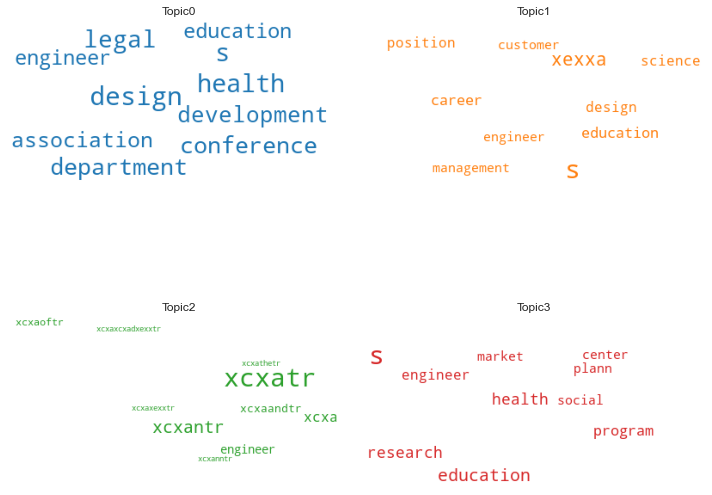

In [1037]:
import matplotlib.colors as mcolors


cols = [color for name , color in mcolors.TABLEAU_COLORS.items()]

wordcloud = WordCloud(
        background_color='white',
        stopwords=stopwords,
        max_words=10,
        max_font_size=30, 
        prefer_horizontal=1.0,
        colormap='tab10',
    color_func= lambda *args , **kwargs : cols[i]
        
)

topics = ldamodel.show_topics(num_topics=4, num_words=10 , formatted=False)   
    
fig , axes = plt.subplots(2,2 , figsize=(10,10),sharex=True , sharey=True)
for i , ax in enumerate(axes.flatten()):
    fig.add_subplot(ax)
    topic_words = dict(topics[i][1])
    wordcloud.generate_from_frequencies(topic_words)
    plt.gca().imshow(wordcloud)
    plt.gca().set_title('Topic'+str(i))
    plt.gca().axis('off')
    

    
plt.subplots_adjust(wspace=0,hspace=0) 
plt.axis('off')
plt.margins(x=0,y=0)
plt.tight_layout()
plt.show()


In [1032]:
## Data split
#from sklearn.model_selection import train_test_split
#X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.20, random_state=42)

/Users/a.groon/opt/anaconda3/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


# K-mean

In [977]:


num_clusters = 4
km = KMeans(n_clusters=num_clusters)
km.fit(WordFeatures)

/Users/a.groon/opt/anaconda3/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


KMeans(n_clusters=4)

/Users/a.groon/opt/anaconda3/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


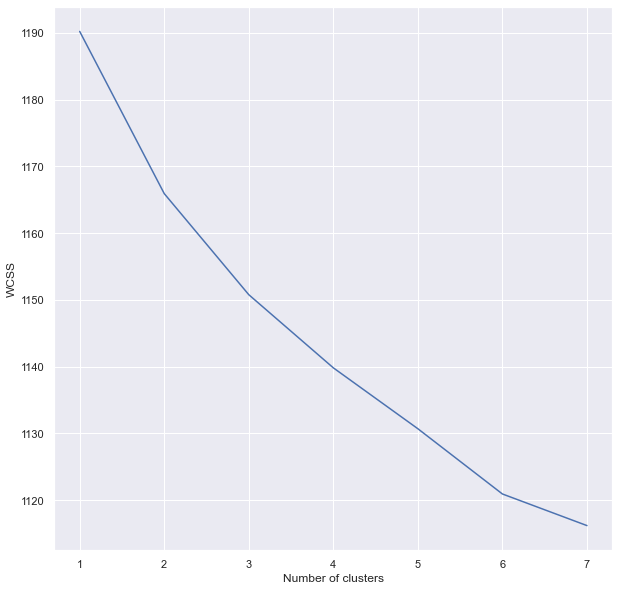

In [978]:
wcss = []
for i in range(1,8):
    model = KMeans(n_clusters = i, init = "k-means++")
    model.fit(WordFeatures)
    wcss.append(model.inertia_)
plt.figure(figsize=(10,10))
plt.plot(range(1,8), wcss)
plt.xlabel('Number of clusters')
plt.ylabel('WCSS')
plt.show()

In [979]:
pca = PCA(2)
data = pca.fit_transform(WordFeatures.toarray())
data

/Users/a.groon/opt/anaconda3/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


array([[ 0.23424151,  0.08091296],
       [ 0.49923213, -0.06005711],
       [ 0.4524418 , -0.04127385],
       ...,
       [-0.06344174, -0.13358789],
       [ 0.02074915, -0.10992536],
       [-0.18615427, -0.0458364 ]])

/Users/a.groon/opt/anaconda3/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


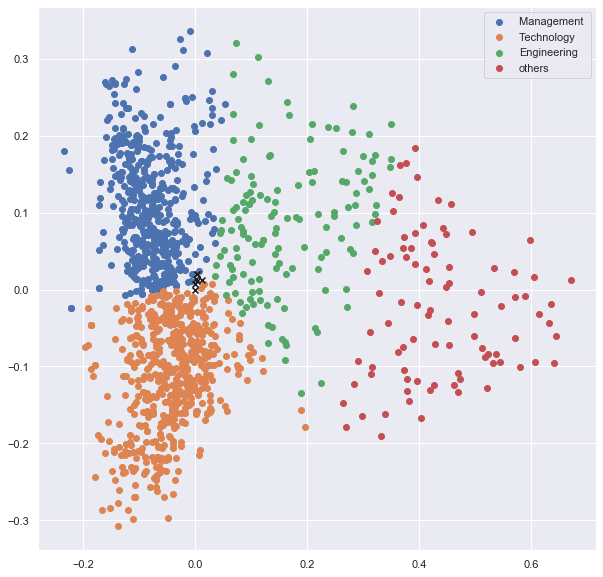

In [980]:
centers = np.array(model.cluster_centers_)
kmeans = KMeans(n_clusters=4)
kmeans.fit_predict(data)
clusters = kmeans.cluster_centers_
model = KMeans(n_clusters = 4, init = "k-means++")
label = model.fit_predict(data)
plt.figure(figsize=(10,10))
uniq = np.unique(label)
for i in uniq:
 
    
    plt.scatter(data[label == i , 0] , data[label == i , 1] , label = i)
plt.scatter(centers[:,0], centers[:,1], marker="x", color='k')
#This is done to find the centroid for each clusters.
plt.legend(('Management ','Technology ','Engineering','others'))
plt.show()

In [981]:
Kmean_df=cx.copy()

/Users/a.groon/opt/anaconda3/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


# SVM With Count Vectorizer

In [987]:
x_train,x_test,y_train,y_test = train_test_split(WordFeatures,requiredTarget,random_state=42, test_size=0.2,
                                               shuffle=True, stratify=requiredTarget)

/Users/a.groon/opt/anaconda3/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [988]:
SVM1 = svm.SVC(probability=True)
SVM1.fit(x_train,y_train)

/Users/a.groon/opt/anaconda3/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


SVC(probability=True)

In [989]:
svr_pred = SVM1.predict(x_test)
svr_acc = accuracy_score(y_test, svr_pred)
print(svr_acc, confusion_matrix(y_test, svr_pred),
      classification_report(y_test, svr_pred), sep = '\n\n')

/Users/a.groon/opt/anaconda3/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


0.5423076923076923

[[11  0  0 ...  1  0  0]
 [ 0 12  0 ...  0  0  0]
 [ 0  0  1 ...  1  0  0]
 ...
 [ 0  0  0 ...  7  0  0]
 [ 0  0  0 ...  0  0  0]
 [ 0  0  0 ...  0  0  0]]

              precision    recall  f1-score   support

           0       0.65      0.85      0.73        13
           1       0.80      0.92      0.86        13
           2       1.00      0.20      0.33         5
           3       0.00      0.00      0.00         3
           4       0.00      0.00      0.00         2
           5       1.00      0.40      0.57        10
           6       0.00      0.00      0.00         1
           7       0.67      0.40      0.50         5
           8       1.00      0.67      0.80         3
           9       0.00      0.00      0.00         5
          10       1.00      0.70      0.82        10
          11       0.00      0.00      0.00         1
          12       0.00      0.00      0.00         6
          13       0.00      0.00      0.00         1
          14

/Users/a.groon/opt/anaconda3/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/a.groon/opt/anaconda3/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/a.groon/opt/anaconda3/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


# SVM With TF-IDF Vectorizer

In [1033]:
SVM = svm.SVC(C=10, gamma=0.1)
SVM.fit(x_train,y_train)

/Users/a.groon/opt/anaconda3/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


SVC(C=10, gamma=0.1)

In [1034]:
SVM.score(x_train,y_train)

/Users/a.groon/opt/anaconda3/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


0.9556412729026037

In [1035]:
svm_pred = SVM.predict(x_test)
svm_acc = accuracy_score(y_test, svm_pred)
print(svm_acc, confusion_matrix(y_test, svm_pred),
      classification_report(y_test, svm_pred), sep = '\n\n')

/Users/a.groon/opt/anaconda3/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


0.6307692307692307

[[11  0  0 ...  1  0  0]
 [ 0 12  0 ...  0  0  0]
 [ 0  0  3 ...  1  0  0]
 ...
 [ 1  0  0 ...  7  0  0]
 [ 0  0  0 ...  0  0  0]
 [ 0  0  0 ...  0  0  0]]

              precision    recall  f1-score   support

           0       0.65      0.85      0.73        13
           1       0.80      0.92      0.86        13
           2       1.00      0.60      0.75         5
           3       0.00      0.00      0.00         3
           4       1.00      0.50      0.67         2
           5       0.44      0.40      0.42        10
           6       1.00      1.00      1.00         1
           7       0.60      0.60      0.60         5
           8       1.00      0.67      0.80         3
           9       1.00      0.40      0.57         5
          10       0.90      0.90      0.90        10
          11       0.00      0.00      0.00         1
          12       0.50      0.17      0.25         6
          13       0.00      0.00      0.00         1
          14

/Users/a.groon/opt/anaconda3/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/a.groon/opt/anaconda3/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/a.groon/opt/anaconda3/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
